# Lab 1 Inroduction



This coursework should be worked on during the scheduled tutorial sessions where you can ask questions if you get stuck.

Let's import all the necessary packages:

In [ ]:
# %matplotlib inline is a magic function for displaying the image in the notebook
%matplotlib inline
import numpy as np
import cv2
import copy
import matplotlib.image as mpimg
from matplotlib import pyplot as plt
from IPython.display import display, Image


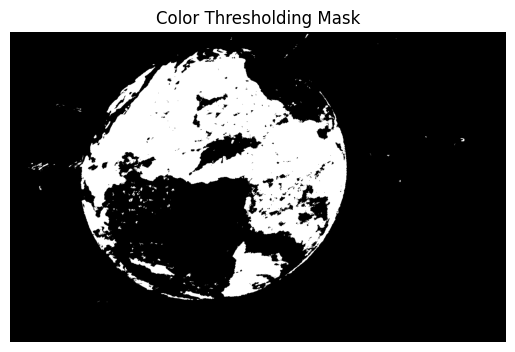

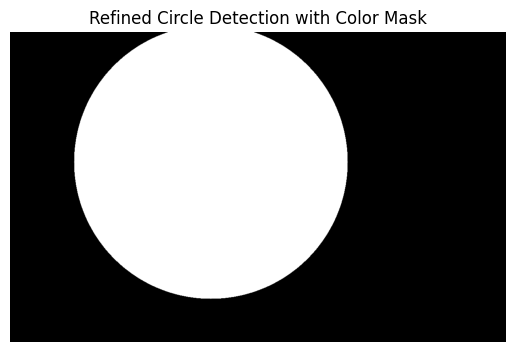

In [7]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def color_thresholding(image, lower_bound, upper_bound):
    """
    Perform color thresholding to segment the globe.

    Parameters:
        image (numpy.ndarray): Input image in BGR format.
        lower_bound (numpy.ndarray): Lower HSV color bound.
        upper_bound (numpy.ndarray): Upper HSV color bound.

    Returns:
        numpy.ndarray: Binary mask highlighting the selected color.
    """
    # Convert image to HSV color space
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    # Apply the color threshold
    mask = cv2.inRange(hsv_image, lower_bound, upper_bound)
    return mask

def refined_circle_detection_with_mask(image, color_mask):
    """
    Detect a single circular shape in the image using a color mask to focus the detection.

    Parameters:
        image (numpy.ndarray): Input image in BGR format.
        color_mask (numpy.ndarray): Binary mask obtained from color thresholding.

    Returns:
        numpy.ndarray: Binary mask with the detected circle.
    """
    # Apply the mask to the image
    masked_image = cv2.bitwise_and(image, image, mask=color_mask)
    # Convert to grayscale
    gray_image = cv2.cvtColor(masked_image, cv2.COLOR_BGR2GRAY)
    # Apply Gaussian blur to reduce noise
    blurred_image = cv2.GaussianBlur(gray_image, (9, 9), 2)
    # Detect circles using HoughCircles with adjusted parameters
    circles = cv2.HoughCircles(
        blurred_image,
        cv2.HOUGH_GRADIENT,
        dp=1.2,
        minDist=200,
        param1=100,
        param2=40,
        minRadius=200,
        maxRadius=500,
    )
    # Create a binary mask with the same dimensions as the input image
    mask = np.zeros_like(gray_image)
    if circles is not None:
        # Get the first (most prominent) circle
        circle = np.round(circles[0, 0]).astype("int")
        x, y, r = circle
        # Draw the circle on the mask
        cv2.circle(mask, (x, y), r, 255, -1)
    return mask

# Load the image
image_path = './Dataset 2/images/000001.png'  # Replace with your image path
image = cv2.imread(image_path)

# Method 1: Color Thresholding
lower_blue = np.array([100, 50, 50])  # Lower bound of blue in HSV
upper_blue = np.array([140, 255, 255])  # Upper bound of blue in HSV
color_mask = color_thresholding(image, lower_blue, upper_blue)

# Display the result of Color Thresholding
plt.imshow(color_mask, cmap='gray')
plt.title("Color Thresholding Mask")
plt.axis("off")
plt.show()

# Method 2: Circle Detection with Color Mask
circle_mask_with_color = refined_circle_detection_with_mask(image, color_mask)

# Display the result of Circle Detection with Color Mask
plt.imshow(circle_mask_with_color, cmap='gray')
plt.title("Refined Circle Detection with Color Mask")
plt.axis("off")
plt.show()


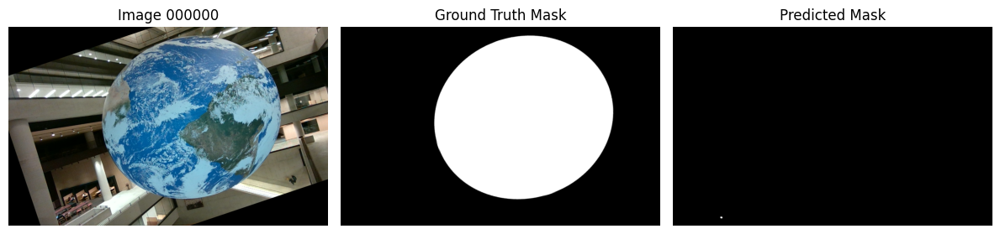

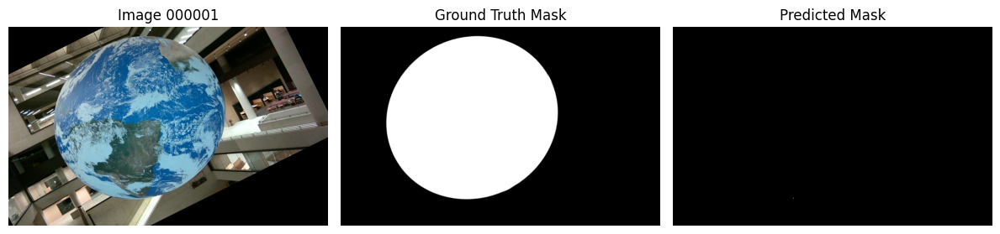

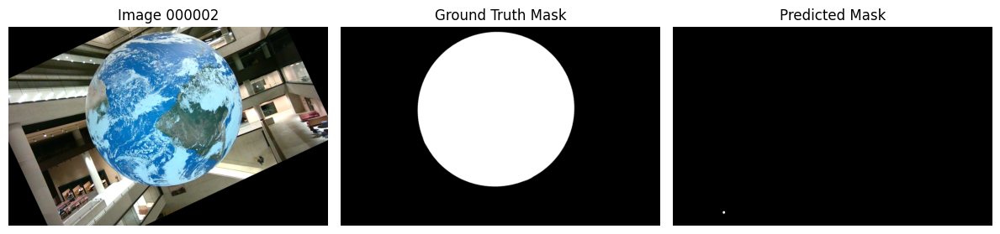

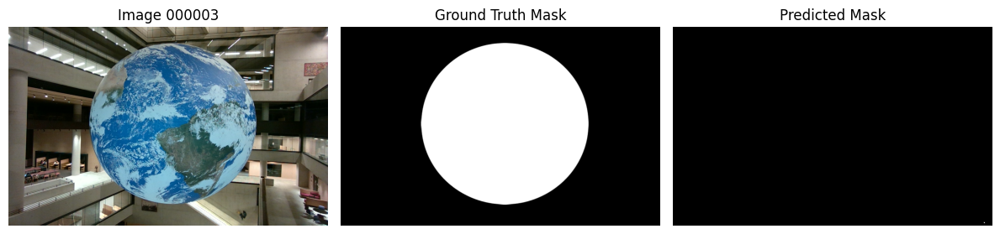

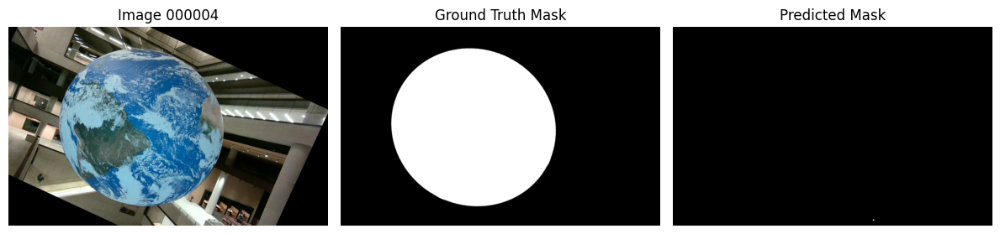

...

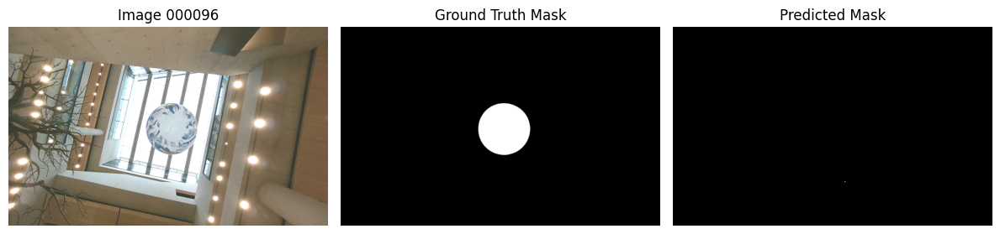

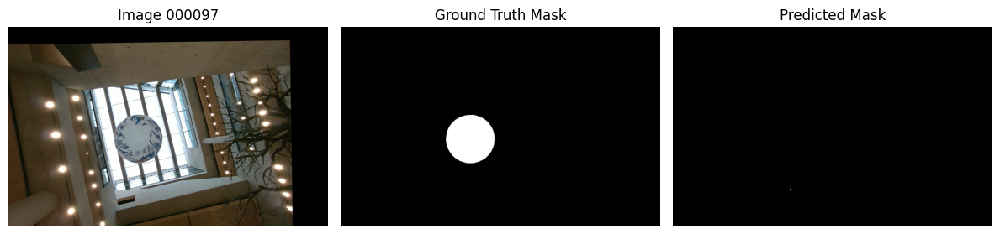

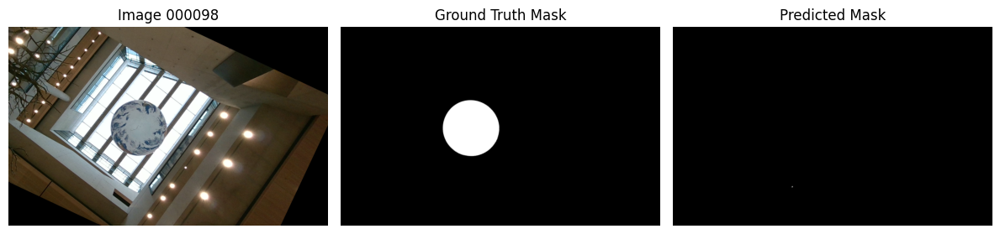

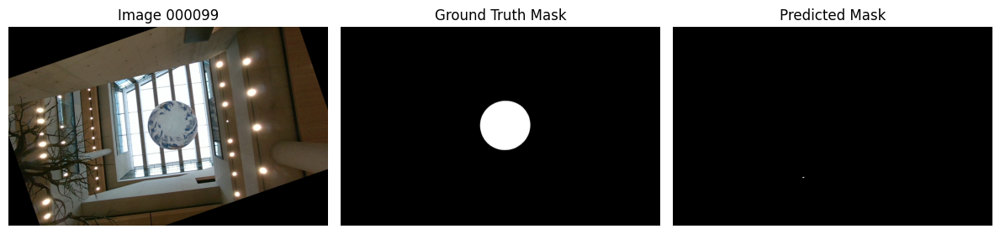

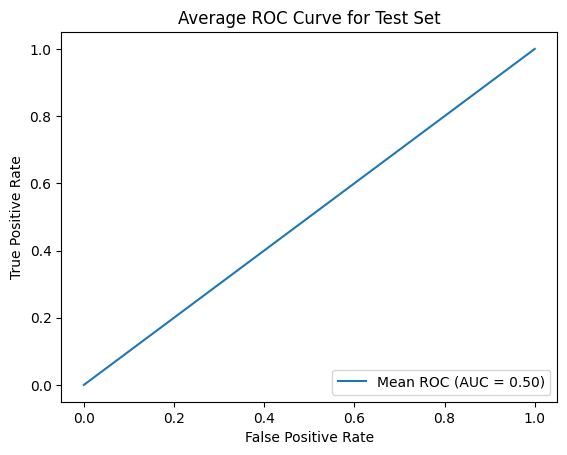

Mean AUC: 0.50


In [14]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
import os

def color_thresholding(image, lower_bound, upper_bound):
    """
    Perform color thresholding to segment the globe.

    Parameters:
        image (numpy.ndarray): Input image in BGR format.
        lower_bound (numpy.ndarray): Lower HSV color bound.
        upper_bound (numpy.ndarray): Upper HSV color bound.

    Returns:
        numpy.ndarray: Binary mask highlighting the selected color.
    """
    # Convert image to HSV color space
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    # Apply the color threshold
    mask = cv2.inRange(hsv_image, lower_bound, upper_bound)
    return mask

def refined_circle_detection_with_mask(image, color_mask):
    """
    Detect a single circular shape in the image using a color mask to focus the detection.

    Parameters:
        image (numpy.ndarray): Input image in BGR format.
        color_mask (numpy.ndarray): Binary mask obtained from color thresholding.

    Returns:
        numpy.ndarray: Binary mask with the detected circle.
    """
    # Apply the mask to the image
    masked_image = cv2.bitwise_and(image, image, mask=color_mask)
    # Convert to grayscale
    gray_image = cv2.cvtColor(masked_image, cv2.COLOR_BGR2GRAY)
    # Apply Gaussian blur to reduce noise
    blurred_image = cv2.GaussianBlur(gray_image, (9, 9), 2)
    # Detect circles using HoughCircles with adjusted parameters
    circles = cv2.HoughCircles(
        blurred_image,
        cv2.HOUGH_GRADIENT,
        dp=1.2,
        minDist=200,
        param1=100,
        param2=40,
        minRadius=200,
        maxRadius=500,
    )
    # Create a binary mask with the same dimensions as the input image
    mask = np.zeros_like(gray_image)
    if circles is not None:
        # Get the first (most prominent) circle
        circle = np.round(circles[0, 0]).astype("int")
        x, y, r = circle
        # Draw the circle on the mask
        cv2.circle(mask, (x, y), r, 255, -1)
    return mask

def refined_ellipse_detection_with_mask(image, color_mask):
    """
    Detect a single elliptical shape in the image using a color mask to focus the detection.

    Parameters:
        image (numpy.ndarray): Input image in BGR format.
        color_mask (numpy.ndarray): Binary mask obtained from color thresholding.

    Returns:
        numpy.ndarray: Binary mask with the detected ellipse.
    """
    # Apply the mask to the image
    masked_image = cv2.bitwise_and(image, image, mask=color_mask)
    # Convert to grayscale
    gray_image = cv2.cvtColor(masked_image, cv2.COLOR_BGR2GRAY)
    # Enhance contrast using CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    enhanced_image = clahe.apply(gray_image)
    # Apply edge detection
    edges = cv2.Canny(enhanced_image, 50, 150)
    # Find contours
    contours, _ = cv2.findContours(edges, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    # Create a binary mask with the same dimensions as the input image
    mask = np.zeros_like(gray_image)
    for contour in contours:
        # Filter contours by size
        if 100 < cv2.contourArea(contour) < 50000:
            # Approximate the contour
            approx = cv2.approxPolyDP(contour, 0.01 * cv2.arcLength(contour, True), True)
            # Fit an ellipse if the contour has sufficient points
            if len(approx) >= 5:
                ellipse = cv2.fitEllipse(approx)
                cv2.ellipse(mask, ellipse, 255, -1)
                break  # Only use the first detected ellipse
    return mask

def compute_roc_curve(predicted_mask, ground_truth_mask):
    """
    Compute ROC curve and AUC for a predicted mask and ground truth mask.

    Parameters:
        predicted_mask (numpy.ndarray): Predicted binary mask.
        ground_truth_mask (numpy.ndarray): Ground truth binary mask.

    Returns:
        tuple: (fpr, tpr, roc_auc) False Positive Rate, True Positive Rate, and Area Under Curve.
    """
    # Binarize the masks
    predicted_binary = (predicted_mask > 0).astype(np.uint8).flatten()
    ground_truth_binary = (ground_truth_mask > 0).astype(np.uint8).flatten()

    # Compute ROC curve
    fpr, tpr, _ = roc_curve(ground_truth_binary, predicted_binary)
    roc_auc = auc(fpr, tpr)

    return fpr, tpr, roc_auc

# Dataset paths
images_folder = './Dataset 2/images/'
masks_folder = './Dataset 2/masks/'

# Bounds for color thresholding
lower_blue = np.array([100, 50, 50])  # Lower bound of blue in HSV
upper_blue = np.array([140, 255, 255])  # Upper bound of blue in HSV

# Lists to store ROC values
all_fpr = []
all_tpr = []
all_auc = []

# Loop through all images and masks
for i in range(100):
    image_path = os.path.join(images_folder, f"{i:06d}.png")
    mask_path = os.path.join(masks_folder, f"{i:06d}.png")

    # Read image and ground truth mask
    image = cv2.imread(image_path)
    ground_truth_mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)

    # Generate color mask
    color_mask = color_thresholding(image, lower_blue, upper_blue)

    # Refine circle detection with color mask
    predicted_mask = refined_ellipse_detection_with_mask(image, color_mask)

    # Compute ROC curve
    fpr, tpr, roc_auc = compute_roc_curve(predicted_mask, ground_truth_mask)

    # Store the results
    all_fpr.append(fpr)
    all_tpr.append(tpr)
    all_auc.append(roc_auc)

    # Plot image, ground truth mask, and predicted mask
    plt.figure(figsize=(12, 4))
    
    plt.subplot(1, 3, 1)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title(f"Image {i:06d}")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(ground_truth_mask, cmap='gray')
    plt.title("Ground Truth Mask")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(predicted_mask, cmap='gray')
    plt.title("Predicted Mask")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

# Compute average ROC curve (mean TPR for each FPR)
mean_fpr = np.linspace(0, 1, 100)
mean_tpr = np.zeros_like(mean_fpr)
for fpr, tpr in zip(all_fpr, all_tpr):
    mean_tpr += np.interp(mean_fpr, fpr, tpr)
mean_tpr /= len(all_tpr)
mean_auc = auc(mean_fpr, mean_tpr)

# Plot average ROC curve
plt.figure()
plt.plot(mean_fpr, mean_tpr, label=f"Mean ROC (AUC = {mean_auc:.2f})")
plt.title("Average ROC Curve for Test Set")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend(loc="lower right")
plt.show()

# Print mean AUC
print(f"Mean AUC: {mean_auc:.2f}")
